In [1]:
import sys
sys.path.insert(0, '/home/users/brezovec/.local/lib/python3.6/site-packages/lib/python/')
import ants
import os
import bigbadbrain as bbb
import numpy as np
import matplotlib.pyplot as plt
import time
import scipy
from scipy.ndimage.filters import gaussian_filter
from scipy.ndimage.filters import gaussian_filter1d
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d

from skimage.filters import threshold_triangle
sys.path.insert(0, '/home/users/brezovec/.local/lib/python3.6/site-packages')
import os
import statsmodels.api as sm
import cv2
import matplotlib.patches as mpatches
import psutil
from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib.colors import Normalize
import matplotlib.colors as mcolors
from matplotlib import colors

%matplotlib inline
plt.rcParams.update({'font.size': 20})

from sklearn.feature_extraction.image import grid_to_graph
from mpl_toolkits.axes_grid1 import ImageGrid
import json
from matplotlib.ticker import FuncFormatter

import nibabel as nib

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import fcluster
from scipy.cluster import hierarchy
import itertools
import random
import matplotlib as mpl
from matplotlib.pyplot import cm

from scipy.interpolate import UnivariateSpline
from sklearn.linear_model import LinearRegression
import matplotlib.patches as patches

from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV

from scipy.fftpack import fft,fftshift,ifft
from scipy import signal
import pickle
from tqdm import tqdm
from shutil import copyfile
import cv2
from scipy.ndimage.morphology import binary_erosion
from scipy.ndimage.morphology import binary_dilation

In [2]:
### Load Luke Mean ###

luke_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/20210310_luke_exp_thresh.nii"
res_luke_mean = (0.65,0.65,1)
luke_mean = np.asarray(nib.load(luke_path).get_data().squeeze(), dtype='float32')
luke_mean = luke_mean[:,:,::-1] #flipz
luke_mean = ants.from_numpy(luke_mean)
luke_mean.set_spacing(res_luke_mean)
luke_mean_lowres =  ants.resample_image(luke_mean,(256,128,49),use_voxels=True)

In [3]:
### Load JFRC2018 ###

fixed_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/JRC2018_FEMALE_38um_iso_16bit.nii"
res_JRC2018 = (0.38, 0.38, 0.38)
fixed = np.asarray(nib.load(fixed_path).get_data().squeeze(), dtype='float32')
fixed = ants.from_numpy(fixed)
fixed.set_spacing(res_JRC2018)
fixed_lowres = ants.resample_image(fixed,(2,2,2),use_voxels=False)

In [5]:
######################
### Voxel-res corr ###
######################

dataset_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/20210420_correlation/"
behaviors = ['Y_pos', 'Z_pos', 'Z_neg']
maps = {}
for behavior in behaviors:
    rvalues_to_load = [os.path.join(dataset_path, x) for x in os.listdir(dataset_path) if 'rvalues_{}'.format(behavior) in x]
    bbb.sort_nicely(rvalues_to_load)

    pvalues_to_load = [os.path.join(dataset_path, x) for x in os.listdir(dataset_path) if 'pvalues_{}'.format(behavior) in x]
    bbb.sort_nicely(pvalues_to_load)
    
    r_map = []
    p_map = []
    for z in range(49):
        r_map.append(np.load(rvalues_to_load[z]))
        p_map.append(np.load(pvalues_to_load[z]))

    r_map = np.asarray(r_map)
    p_map = np.asarray(p_map)
    
    r_map = np.reshape(r_map, (49,256,128))
    p_map = np.reshape(p_map, (49,256,128))
    
    r_map[p_map >= 1e-4]=0
    
    maps[behavior] = r_map
    
############################################
### Put into plotting format with colors ###
############################################

slices = []
for z in range(49):
    colors1 = maps['Z_neg'][z,:,:].T
    colors2 = maps['Z_pos'][z,:,:].T
    colors3 = maps['Y_pos'][z,:,:].T
    to_plot = np.stack((colors1,colors2,colors3),axis=2)
    slices.append(to_plot)
slices = np.asarray(slices)

func = np.swapaxes(slices, 0, 2)
func.shape

res_LUKE = (2.6, 2.6, 5, 1)
moving = ants.from_numpy(func[:,:,::-1,:])
moving.set_spacing(res_LUKE)

In [37]:
##################
### Unique GLM ###
##################

### Load supervoxel labels ###
n_clusters = 2000
labels_file = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/20201129_super_slices/cluster_labels.npy'
cluster_model_labels = np.load(labels_file)

### load glm ###
main_dir = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/20210208_inst_uniq_glm/'
all_scores = []
for z in range(49):
    file = [os.path.join(main_dir, i) for i in os.listdir(main_dir) if f'Z{z}.' in i][0]
    with open(file, 'rb') as handle:
        scores = pickle.load(handle)
    all_scores.append(scores)
    
uniques = ['scores_ypos_unique', 'scores_zpos_unique', 'scores_zneg_unique']
maps = {}

for unique in uniques:
    all_colored_by_betas = []
    for z in range(49):
        colored_by_betas = np.zeros(256*128)
        for cluster_num in range(len(np.unique(cluster_model_labels[z]))):
            cluster_indicies = np.where(cluster_model_labels[z]==cluster_num)[0]
            colored_by_betas[cluster_indicies] = all_scores[z]['scores_all'][cluster_num] - all_scores[z][unique][cluster_num]

            if len(cluster_indicies) > 100:
                colored_by_betas[cluster_indicies] = 0
            if colored_by_betas[cluster_indicies][0] == 1:
                colored_by_betas[cluster_indicies] = 0
        colored_by_betas = colored_by_betas.reshape(256,128)
        all_colored_by_betas.append(colored_by_betas)
    all_colored_by_betas = np.asarray(all_colored_by_betas)
    maps[unique] = all_colored_by_betas
    
############################################
### Put into plotting format with colors ###
############################################

slices = []
for z in range(49):
    colors1 = maps['scores_zneg_unique'][z,:,:].T
    colors2 = maps['scores_zpos_unique'][z,:,:].T
    colors3 = maps['scores_ypos_unique'][z,:,:].T
    to_plot = np.stack((colors1,colors2,colors3),axis=2)
    slices.append(to_plot)
slices = np.asarray(slices)
func = np.swapaxes(slices, 0, 2)
moving = ants.from_numpy(func[:,:,::-1,:])
res_LUKE = (2.6, 2.6, 5, 1)
moving.set_spacing(res_LUKE)

deconvolving
0
1
2
getting peaks
0
1
2


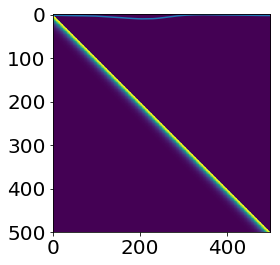

In [4]:
################
### TEMPORAL ###
################

### Load supervoxel labels ###
n_clusters = 2000
labels_file = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/20201129_super_slices/cluster_labels.npy'
cluster_model_labels = np.load(labels_file)

###########################
### Create Notch Filter ###
###########################

fs = 50.0  # Sample frequency (Hz)
f0 = 1.8797  # Frequency to be removed from signal (Hz)
Q = 0.2  # Quality factor <---- IMPORTANT
w0 = f0/(fs/2)  # Normalized Frequency

# Design notch filter
b_notch, a_notch = signal.iirnotch(w0, Q)

# Frequency response
w, h = signal.freqz(b_notch, a_notch)

# Generate frequency axis
freq = w*fs/(2*np.pi)

###########################################
### Create estimate of gcamp6f kinetics ###
###########################################

def fit_eq(x, a, b, c, d, e):
    return a*(1-np.exp(-x/b))*(c*np.exp(-x/d)) + e

x = np.arange(0, 50, 1)
y = fit_eq(x, 1, 4, -1, 8, 0)

filter_ = y*-1
filter_padded = np.pad(filter_, (0, 450), 'constant')

toe = scipy.linalg.toeplitz(filter_padded,r=[0]*500)
plt.imshow(toe)

main_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/20210316_neural_weighted_behavior"

response_files = [os.path.join(main_path, file) for file in os.listdir(main_path) if 'responses' in file]
bbb.sort_nicely(response_files)

responses = []
for file in response_files:
    responses.append(np.load(file))
responses = np.asarray(responses)

responses_split = np.reshape(responses, (49-18,2000,4,500))
responses_notch = signal.filtfilt(b_notch, a_notch, responses_split, axis=-1)

cluster_id = np.argmax(np.sum(responses_notch[20,:,0,:].real, axis=1))
plt.plot(responses_notch[20,cluster_id,0,:])

##################
### Deconvolve ###
##################
print('deconvolving')

all_signals_unfiltered = np.reshape(responses_split[:,:,:,:],(31*2000,4,500))
all_signals = np.reshape(responses_notch,(31*2000,4,500))

all_signals_flipped = all_signals[:,:,::-1]
all_signals_deconv = []
for beh_idx in [0,1,2]:
    print(beh_idx)
    # flip filters in time
    temp = all_signals_flipped[:,beh_idx,:]

    # deconvolve
    deconv = np.linalg.lstsq(toe, temp.T)[0]
    deconv_smooth = gaussian_filter1d(deconv,sigma=3,axis=0)

    # Remove edge artifact
    deconv_smooth[:5,:] = deconv_smooth[5,:]
    deconv_smooth[-5:,:] = deconv_smooth[-5,:]

    # Flip back to being backwards in time
    deconv_smooth = deconv_smooth[::-1,:]
    all_signals_deconv.append(deconv_smooth)
all_signals_deconv = np.asarray(all_signals_deconv)
all_signals_deconv = np.swapaxes(all_signals_deconv,0,1)
all_signals_deconv = np.swapaxes(all_signals_deconv,0,2)

######################
### Get peaks, etc ###
######################
print('getting peaks')

all_maxs = np.max(np.abs(all_signals_deconv),axis=-1)
thresholds = np.percentile(all_maxs,60,axis=0)

peaks = {}
peaks_ms = {}
peaks_unfiltered = {}
thresholded_filters_norm = {}
thresholded_filters_norm_unfiltered = {}
to_delete = {}
for beh_idx in [0,1,2]:
    print(beh_idx)
    to_delete_ = np.where(all_maxs[:,beh_idx]<thresholds[beh_idx])
    thresholded_filters = np.delete(all_signals_deconv[:,beh_idx,:], to_delete_, axis=0)
    
    # add gaussian smoothing
    thresholded_filters = gaussian_filter1d(thresholded_filters,sigma=2,axis=-1)
    
    peaks_ = np.argmax(thresholded_filters,axis=-1)
    #idx_sort = np.argsort(peaks)
    maxs = np.max(thresholded_filters,axis=-1)
    thresholded_filters_norm_ = thresholded_filters/maxs[:,np.newaxis]
    
    peaks[beh_idx] = peaks_
    peaks_ms[beh_idx] = (peaks_-250)*20
    thresholded_filters_norm[beh_idx] = thresholded_filters_norm_
    to_delete[beh_idx] = to_delete_
    
    thresholded_filters_unfiltered = np.delete(all_signals_unfiltered[:,beh_idx,:], to_delete_, axis=0)
    maxs = np.max(thresholded_filters_unfiltered,axis=-1)
    thresholded_filters_norm_ = thresholded_filters_unfiltered/maxs[:,np.newaxis]
    thresholded_filters_norm_unfiltered[beh_idx] = thresholded_filters_norm_
    
    peaks_ = np.argmax(thresholded_filters_unfiltered,axis=-1)
    peaks_unfiltered[beh_idx] = peaks_

(256, 128, 49)

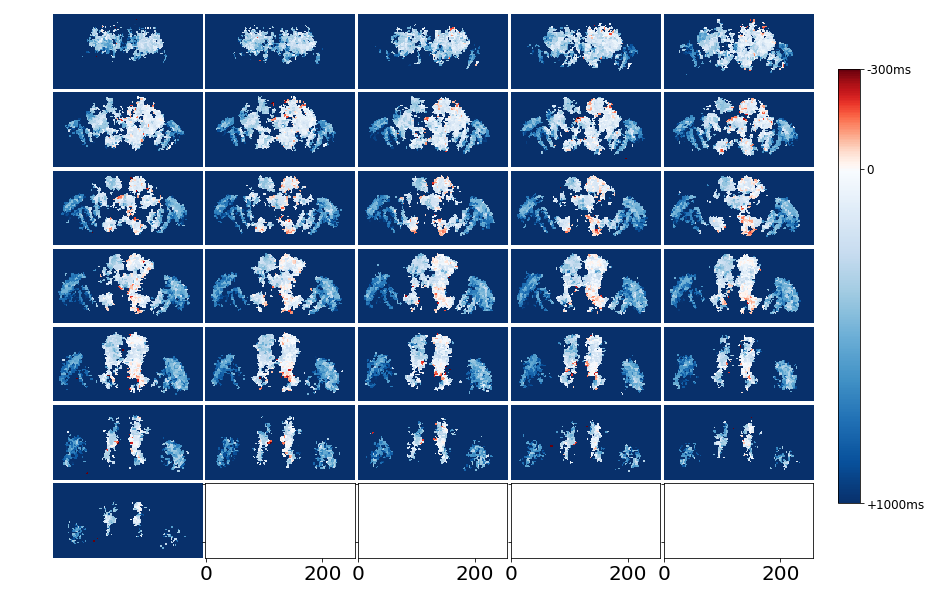

In [23]:
### TEMPORAL CONTINUED ###

for beh_idx in [2]:
    behs = ['Vf', 'Vr+', 'Vr-', 'Wlk']

    add_deleted_voxels = np.zeros(62000)
    to_replace = [i for i in range(62000) if i not in to_delete[beh_idx][0]]
    add_deleted_voxels[to_replace] = peaks[beh_idx] #cluster_ids #model.labels_ ### put signal here
    to_plot = np.reshape(add_deleted_voxels, (31,2000))

    all_colored_by_betas = []
    for z in range(9,49-9):
        colored_by_betas = np.zeros(256*128)
        for cluster_num in range(len(np.unique(cluster_model_labels[z]))):
            cluster_indicies = np.where(cluster_model_labels[z]==cluster_num)[0]
            colored_by_betas[cluster_indicies] = to_plot[z-9,cluster_num]
        colored_by_betas = colored_by_betas.reshape(256,128)
        all_colored_by_betas.append(colored_by_betas)
    all_colored_by_betas = np.asarray(all_colored_by_betas)
    # to_plot = np.max(all_colored_by_betas, axis=0)
    # plt.imshow(to_plot[:,:].T)
    all_colored_by_betas[all_colored_by_betas==0] = 0 #np.nan #<--------------------

    start = 265
    end = 200
    middle = 250
    
#     start = 265
#     end = 235
#     middle = 250
    
#     start = 235
#     end = 190
    #middle = 250

    # sample the colormaps that you want to use. Use 128 from each so we get 256
    # colors in total
    colors1 = plt.cm.Blues_r(np.linspace(0., 1, middle-end))
    colors2 = plt.cm.Reds(np.linspace(0, 1, start-middle))

    # combine them and build a new colormap
    colors = np.vstack((colors1, colors2))
    mymap = mcolors.LinearSegmentedColormap.from_list('my_colormap', colors)

    mymap.set_bad(color='grey')

    fig = plt.figure(figsize=(20,10))
    grid = ImageGrid(fig, 111, nrows_ncols=(7, 5), axes_pad=.05)
    for i in range(31):
        cax = grid[i].imshow(all_colored_by_betas[i,:,:].T,cmap=mymap,vmin=end,vmax=start);
        #cax = grid[i].imshow(all_colored_by_betas[i,:,:].T,cmap='jet',vmin=end,vmax=start);
        grid[i].axis('off')

    cbar = fig.colorbar(cax, ticks=[start, middle, end],shrink=.8, anchor=(.1,.5))
    cbar.ax.set_yticklabels(['-300ms', '0', '+1000ms'], fontsize=12)

#     cbar = fig.colorbar(cax, ticks=[start, end],shrink=.8, anchor=(.1,.5))
#     cbar.ax.set_yticklabels(['+300ms', '+1000ms'], fontsize=12)

    #plt.suptitle(f'{behs[beh_idx]}',y=.93)

    save_path = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/figs'
    timestr = time.strftime("%Y%m%d-%H%M%S")
    fname = os.path.join(save_path, f'{timestr}')
    #plt.savefig(fname,dpi=300,bbox_inches='tight')

pad = np.zeros((9,256,128))
all_colored_by_betas_full = np.concatenate((pad,all_colored_by_betas,pad))
all_colored_by_betas_full = np.moveaxis(all_colored_by_betas_full,0,2)
all_colored_by_betas_full.shape

# moving = ants.from_numpy(all_colored_by_betas_full[:,:,::-1])
# moving.set_spacing((2.6076, 2.6154, 5.3125)) ### matching this to the slightly off luke mean
# out = ants.registration(fixed_lowres, luke_mean_lowres, type_of_transform='Affine')
# maps_voxel_res = ants.apply_transforms(fixed_lowres, moving, out['fwdtransforms'][0], interpolator='nearestNeighbor')
# temporal_map = maps_voxel_res.numpy()
# print(temporal_map.shape)

In [24]:
moving = ants.from_numpy(all_colored_by_betas_full[:,:,::-1])

In [25]:
#####################
### Warp map data - temporal version (1 channel)
#####################

moving.set_spacing((2.6076, 2.6154, 5.3125)) ### matching this to the slightly off luke mean
out = ants.registration(fixed_lowres, luke_mean_lowres, type_of_transform='Affine')
maps_voxel_res = ants.apply_transforms(fixed_lowres, moving, out['fwdtransforms'][0], interpolator='nearestNeighbor')
maps_voxel_res.shape

maps_voxel_high_res = ants.resample_image(maps_voxel_res,(1256, 584, 363),use_voxels=True)
maps_voxel_high_res.shape


(1256, 584, 363)

In [38]:
#####################
### Warp map data ###
#####################

moving.set_spacing((2.6076, 2.6154, 5.3125, 1)) ### matching this to the slightly off luke mean
out = ants.registration(fixed_lowres, luke_mean_lowres, type_of_transform='Affine')
maps_voxel_res = ants.apply_transforms(fixed_lowres, moving, out['fwdtransforms'][0], imagetype=3, interpolator='nearestNeighbor')
maps_voxel_res.shape

maps_voxel_high_res = ants.resample_image(maps_voxel_res,(1256, 584, 363, 3),use_voxels=True)
maps_voxel_high_res.shape


In [8]:
def normalize(arr,vmin,vmax):
    t_min = 0
    t_max = 1
    norm_arr = []
    diff = t_max - t_min
    diff_arr = vmax - vmin   
    for i in arr:
        temp = (((i - vmin)*diff)/diff_arr) + t_min
        norm_arr.append(temp)
    return np.asarray(norm_arr)

In [26]:
### MAKE ALPHA ### (TEMPORAL!!!)
signals = maps_voxel_high_res.numpy()
signals_norm = normalize(signals,200,265) #min and max #220 good # 5is 100ms, so this covers 800ms
signals = mymap(signals_norm)

alpha = np.ones((1256, 584, 363))
alpha[np.where(signals[...,0]<0.04)]=0 #stupid hack. these are bluest voxels

signals_alpha = signals.copy()
signals_alpha[...,3] = alpha


In [10]:
signals_alpha_vf = signals_alpha.copy()

In [21]:
signals_alpha_vl = signals_alpha.copy()

In [27]:
signals_alpha_vr = signals_alpha.copy()

In [107]:
signals_alpha.shape

(1256, 584, 363, 4)

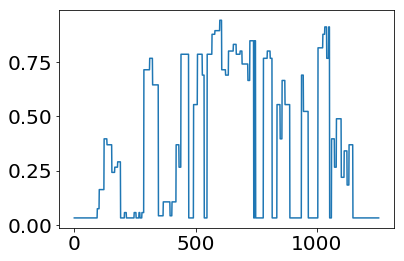

In [99]:
plt.plot(signals[:,250,250,0])

In [103]:
signals[0,250,250,0]

0.03137254901960784

In [96]:
alpha.shape

(1256, 584, 363)

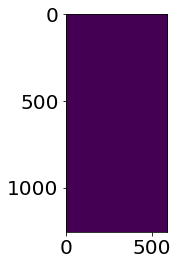

In [97]:
plt.imshow(alpha[:,:,200])

In [64]:
### MAKE ALPHA ### (corrs or unique)
signals = maps_voxel_high_res.numpy()
alpha = np.ones((1256, 584, 363))
#alpha[np.where(np.sum(signals,axis=-1)==0)]=0 # Corrs
alpha[np.where(np.sum(signals,axis=-1)<0.01)]=0 # Unique GLM
signals_alpha = np.concatenate((signals,alpha[..., np.newaxis]),axis=-1)

ValueError: all the input arrays must have same number of dimensions

In [11]:
###########################
### Get highres anatomy ###
###########################

### Load Luke Mean ###
luke_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/20210310_luke_exp_thresh.nii"
res_luke_mean = (0.65,0.65,1)
luke_mean = np.asarray(nib.load(luke_path).get_data().squeeze(), dtype='float32')
luke_mean = luke_mean[:,:,::-1] #flipz
luke_mean = ants.from_numpy(luke_mean)
luke_mean.set_spacing(res_luke_mean)

### Load JFRC2018 ###

fixed_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/JRC2018_FEMALE_38um_iso_16bit.nii"
res_JRC2018 = (0.38, 0.38, 0.38)
fixed = np.asarray(nib.load(fixed_path).get_data().squeeze(), dtype='float32')
fixed = ants.from_numpy(fixed)
fixed.set_spacing(res_JRC2018)
fixed_highres = ants.resample_image(fixed,(1256, 584, 363),use_voxels=True)

In [ ]:
#highres_anat = ants.registration(fixed_highres, luke_mean, type_of_transform='Affine')

In [12]:
file = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/20210817_luke_mean_highres.nii"
highres_anat = np.asarray(nib.load(file).get_data().squeeze(), dtype='float32')
highres_anat.shape

(1256, 584, 363)

In [13]:
##################
### Load Atlas ###
##################

atlas_path = "/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/anat_templates/jfrc_2018_rois_improve_reorient_transformed_nearest_neighbor.nii"
atlas = np.asarray(nib.load(atlas_path).get_data().squeeze(), dtype='float32')
atlas = ants.from_numpy(atlas)
atlas.set_spacing((.76,.76,.76))
atlas = ants.resample_image(atlas,(.5,.5,.5),use_voxels=False)
atlas = atlas.numpy()
atlas_int = atlas.astype('uint8')
atlas_int.shape

(1256, 584, 363)

In [14]:
# have manually swapped R and Ls
rois = {26: 'FB',
4: 'NO',
5: 'BU_L',
54: 'BU_R',
8: 'LAL_L',
56: 'LAL_R',
31: 'PVLP_L',
76: 'PVLP_R',
6: 'PB',
23: 'EB',
13: 'VES_L',  
40: 'EPA_L',
35: 'GOR_L',
11: 'AMMC_L',
60: 'VES_R', 
85: 'EPA_R',
80: 'GOR_R',
58: 'AMMC_R',
50: 'PRW',
9: 'SAD',
49: 'GNG',
30: 'AVLP_L',
75: 'AVLP_R',
24: 'AL_L',
70: 'AL_R',
64: 'MB_PED_R',
65: 'MB_VL_R',
66: 'MB_ML_R',
81: 'MB_CA_R',
17: 'MB_PED_L',
18: 'MB_VL_L',
19: 'MB_ML_L',
36: 'MB_CA_L',
32: 'IVLP_L',
77: 'IVLP_R',
10: 'CAN_L',
20: 'FLA_L',
57: 'CAN_R',
67: 'FLA_R',
27: 'SLP_L',
29: 'SMP_L',
33: 'PLP_L',
7: 'LH_L',
38: 'IPS_L',
37: 'SPS_L',
16: 'CRE_L',
39: 'SCL_L',
12: 'ICL_L',
15: 'ATL_L',
14: 'IB_L',
28: 'SIP_L',#####
72: 'SLP_R',   
74: 'SMP_R',
78: 'PLP_R',
55: 'LH_R',
83: 'IPS_R',
82: 'SPS_R',
63: 'CRE_R',
84: 'SCL_R',  
59: 'ICL_R',
62: 'ATL_R',
61: 'IB_R',
73: 'SIP_R',
25: 'MED_L',
3: 'LO_L',
22: 'LP_L',
34: 'AOTU_L',
71: 'MED_R',
53: 'LO_R',
69: 'LP_R',
79: 'AOTU_R'}

In [ ]:
##########################
### find ROI centroids ###
##########################

all_roi_labels = []
for z in range(584):
    roi_labels = {}
    for roi in np.unique(atlas_int[:,z,:]):
        vox_cnt = len(np.where(atlas_int[:,z,:]==roi)[0])
        if vox_cnt < 1000:
            continue
        if roi == 0:
            continue
        mask = np.zeros((1256,363))
        mask[np.where(atlas[:,z,:]==roi)]=1
        mask = mask.astype('uint8')
        M = cv2.moments(mask)
        cY = int(M["m10"] / M["m00"])
        cX = int(M["m01"] / M["m00"])
        roi_labels[roi] = (cX,cY)
    all_roi_labels.append(roi_labels)

In [15]:
##########################
### find ROI centroids ###
##########################


### For coronal slices:
all_roi_labels = []
for z in tqdm(range(363)):
    roi_labels = {}
    for roi in np.unique(atlas_int[:,:,z]):
        vox_cnt = len(np.where(atlas_int[:,:,z]==roi)[0])
        if vox_cnt < 1000:
            continue
        if roi == 0:
            continue
        mask = np.zeros((1256,584))
        mask[np.where(atlas[:,:,z]==roi)]=1
        mask = mask.astype('uint8')
        M = cv2.moments(mask)
        cY = int(M["m10"] / M["m00"])
        cX = int(M["m01"] / M["m00"])
        roi_labels[roi] = (cX,cY)
    all_roi_labels.append(roi_labels)

100%|██████████| 363/363 [01:11<00:00,  5.08it/s]


In [28]:
atlas_int.shape

(1256, 584, 363)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


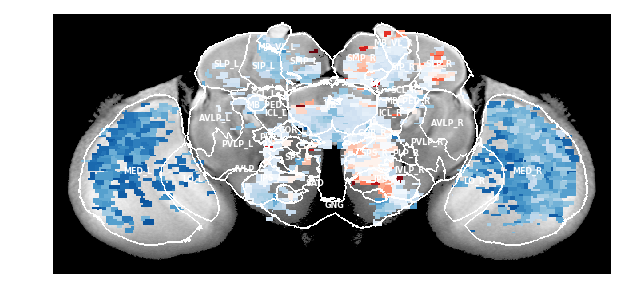

In [28]:
#for z in tqdm(range(0,363,2)):
z=200

# get edges for this slice
edges = cv2.Canny(atlas_int[:,:,z],1,1)
edges = binary_dilation(edges, iterations=1)
edges = scipy.ndimage.median_filter(edges,2)
edges_ = np.repeat(edges.astype('int')[:,:,np.newaxis],repeats=4,axis=-1) ### copy into rgba channels to make white

plt.figure(figsize=(10,10))
plt.imshow(highres_anat[:,:,z].T,cmap='gray')
plt.imshow(np.swapaxes(signals_alpha_vr[:,:,z,:],0,1)) #*20 or 50 the signals for corr or glm
plt.imshow(np.swapaxes(edges_,0,1)*10000)

for roi in all_roi_labels[z]: #replace first 0 with z
    try:
        plt.text(x=all_roi_labels[z][roi][0], #replace first 0 with z
                 y=all_roi_labels[z][roi][1],
                 s=rois[roi],fontsize=8,ha='center',color='w',
                 fontweight='heavy')
    except KeyError:
        plt.text(x=all_roi_labels[z][roi][0],
                 y=all_roi_labels[z][roi][1],
                 s='?',fontsize=12,ha='center',color='w')

plt.axis('off')
save_path = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/figs/20220124_unique_glm_video/coronal'
timestr = time.strftime("%Y%m%d-%H%M%S")
label = format(z, '03d')
fname = os.path.join(save_path, f'{label}')
#plt.savefig(fname,dpi=100,bbox_inches='tight')

 11%|█         | 20/182 [00:19<02:24,  1.12it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 12%|█▏        | 21/182 [00:20<02:25,  1.10it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 12%|█▏        | 22/182 [00:21<02:27,  1.08it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 23%|██▎       | 42/182 [00:42<02:23,  1.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 24%|██▎       | 43/182 [00:43<02:22,  1.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 24%|██▍       | 44/182 [00:44<02:20,  1.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 35%|███▌      | 64/182 [01:11<02:29,  1.27s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 36%|███▌      | 65/182 [01:12<02:29,  1.28s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 36%|███▋      | 66/182 

 47%|████▋     | 85/182 [01:37<02:02,  1.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 47%|████▋     | 86/182 [01:39<02:09,  1.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 48%|████▊     | 87/182 [01:40<02:05,  1.32s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 59%|█████▉    | 107/182 [02:06<01:37,  1.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 59%|█████▉    | 108/182 [02:08<01:43,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 60%|█████▉    | 109/182 [02:09<01:37,  1.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 71%|███████   | 129/182 [02:34<01:06,  1.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 71%|███████▏  | 130/182 [02:36<01:04,  1.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 72%|███████▏  | 131/1

 82%|████████▏ | 150/182 [02:59<00:37,  1.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 83%|████████▎ | 151/182 [03:01<00:36,  1.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 84%|████████▎ | 152/182 [03:02<00:35,  1.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 95%|█████████▍| 172/182 [03:24<00:10,  1.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 95%|█████████▌| 173/182 [03:25<00:09,  1.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 96%|█████████▌| 174/182 [03:26<00:07,  1.00it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats 

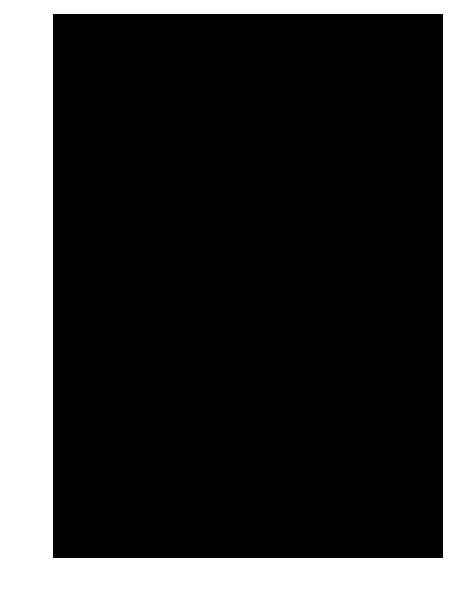

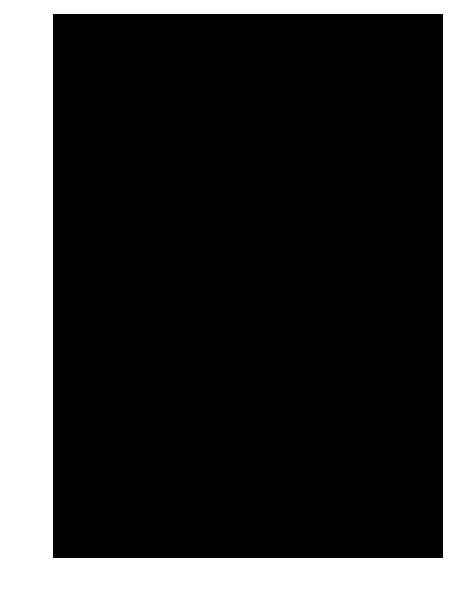

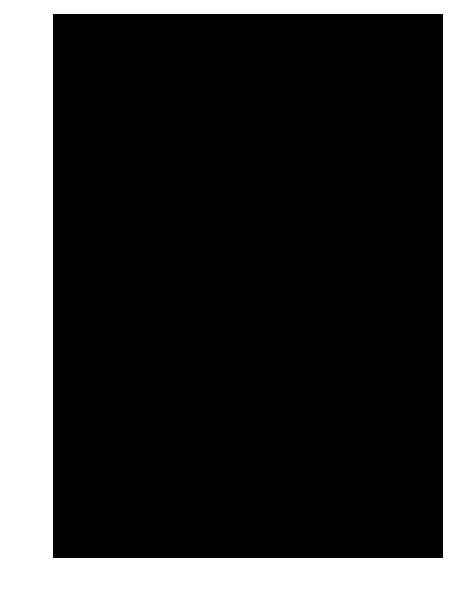

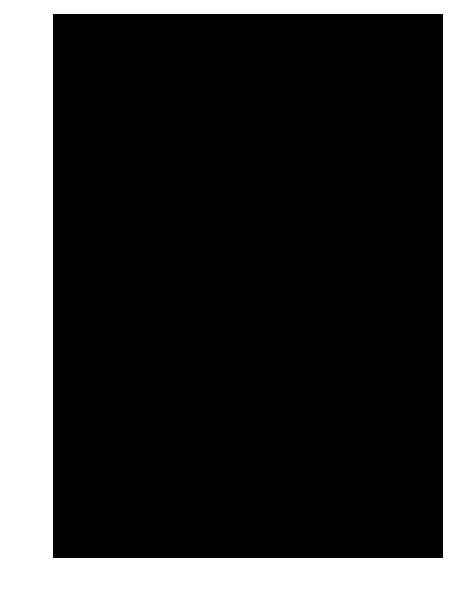

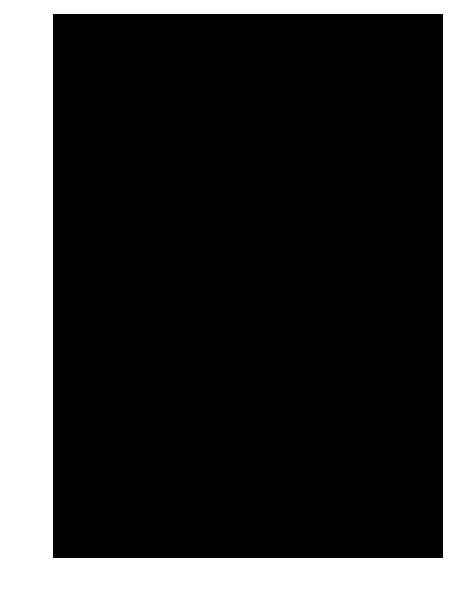

...

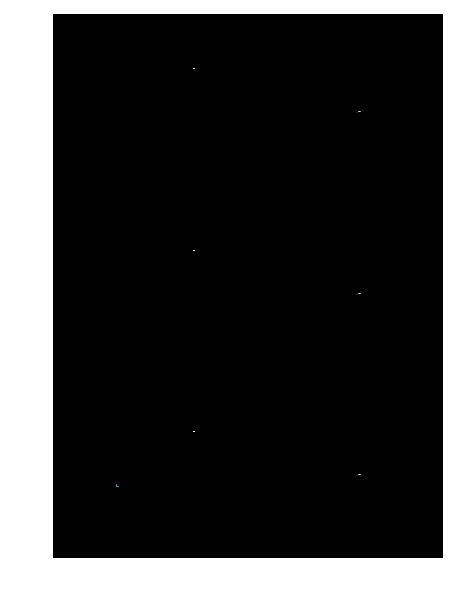

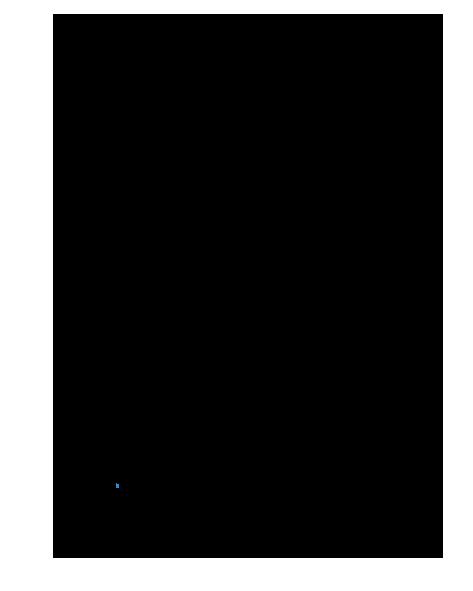

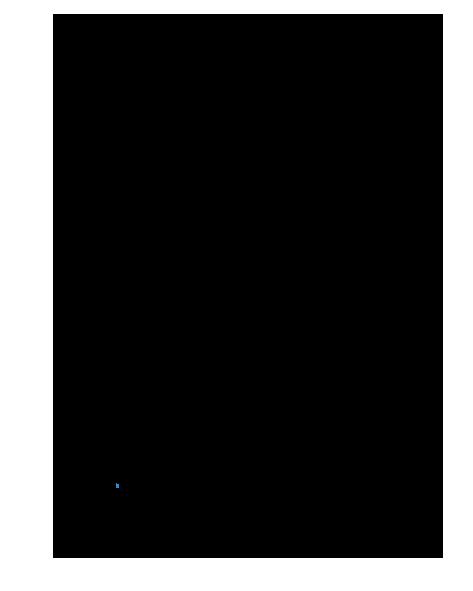

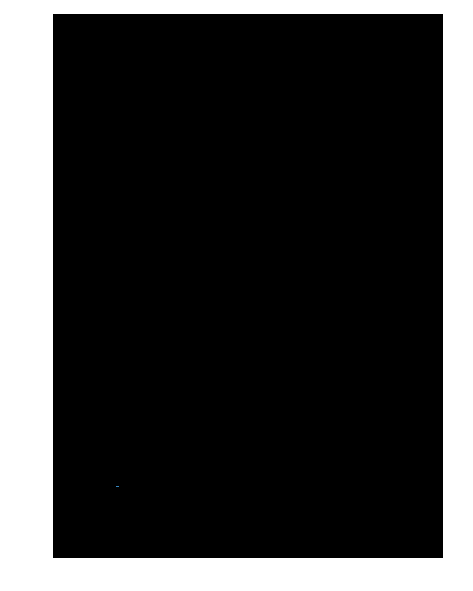

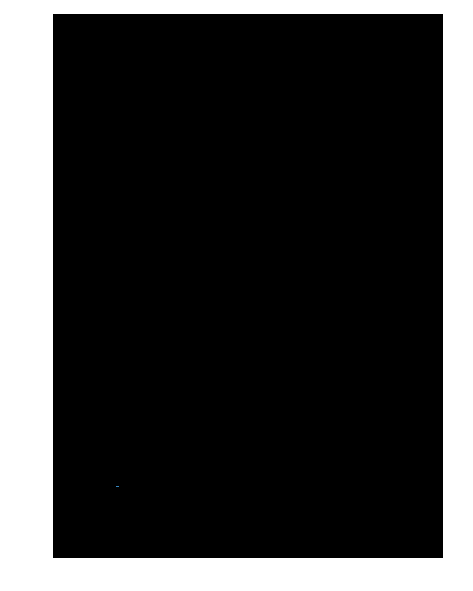

In [ ]:
### for triple view of all three temporal components

for z in tqdm(range(0,363,2)):
    #z=200

    # get edges for this slice
    edges = cv2.Canny(atlas_int[:,:,z],1,1)
    edges = binary_dilation(edges, iterations=1)
    edges = scipy.ndimage.median_filter(edges,2)
    edges_ = np.repeat(edges.astype('int')[:,:,np.newaxis],repeats=4,axis=-1) ### copy into rgba channels to make white

    plt.figure(figsize=(10,10))

    for j in range(3):
        plt.subplot(3,1,j+1)
        plt.imshow(highres_anat[:,:,z].T,cmap='gray')
        if j == 0:
            signals = signals_alpha_vf
        if j == 1:
            signals = signals_alpha_vl
        if j == 2:
            signals = signals_alpha_vr
        plt.imshow(np.swapaxes(signals[:,:,z,:],0,1)) #*20 or 50 the signals for corr or glm
        plt.imshow(np.swapaxes(edges_,0,1)*10000)

        for roi in all_roi_labels[z]: #replace first 0 with z
            try:
                plt.text(x=all_roi_labels[z][roi][0], #replace first 0 with z
                         y=all_roi_labels[z][roi][1],
                         s=rois[roi],fontsize=8,ha='center',color='w',
                         fontweight='heavy')
            except KeyError:
                plt.text(x=all_roi_labels[z][roi][0],
                         y=all_roi_labels[z][roi][1],
                         s='?',fontsize=12,ha='center',color='w')
        plt.axis('off')

    plt.subplots_adjust(wspace=0, hspace=0)


    save_path = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/figs/20220124_temporal_peaks_video/coronal'
    timestr = time.strftime("%Y%m%d-%H%M%S")
    label = format(z, '03d')
    fname = os.path.join(save_path, f'{label}')
    plt.savefig(fname,dpi=100,bbox_inches='tight')

In [33]:
save_path = '/oak/stanford/groups/trc/data/Brezovec/2P_Imaging/figs/20220124_temporal_peaks_video/coronal'
os.mkdir(save_path)